Homework 4 — (15 points)
======
### What to hand in
You are to submit the following things for this homework:
1. A Jupyter notebook containing all code and output (figures and audio). I should be able to evaluate the file to reproduce all output. 
1. Any other data that we tell you to save to a file (e.g. audio files).

### How to hand it in
To submit your lab:
1. Compress all of the files specified into a .zip file. 
1. Name the file in the following manner, firstname_lastname_hw1.zip. For example, Bryan_Pardo_hw1.zip. 
1. Submit this .zip file via Canvas

### Run this code block 1st, to import the needed packages

In [1]:
# This line is a convenience to import most packages you'll need. You may need to import others (eg random and cmath)
import IPython, numpy as np, scipy as sp, matplotlib.pyplot as plt, matplotlib, sklearn, librosa, cmath,math
from IPython.display import Audio
 
# This line makes sure your plots happen IN the webpage you're building, instead of in separate windows.
%matplotlib inline

/Users/Atul/miniconda2/envs/eecs352/lib/python2.7/site-packages/librosa/core/audio.py:37: UserWarning: Could not import scikits.samplerate. Falling back to scipy.signal
  warnings.warn('Could not import scikits.samplerate. '


### Some useful code

####  STFT 

In [2]:
from scipy.fftpack import fft
from scipy.signal import hann

def stft(signal, window_size, hop_size, window_type = 'hann'):
    """
    Computes the short term fourier transform of a 1-D numpy array, where the array 
    is windowed into a set of subarrays, each of length window_size. The distance between
    window centers (in samples) is given by hop_size. The type of window applied is
    determined by window_type. This returns a 2-D numpy array where the ith column
    is the FFT of the ith window. Each column contains an array of complex values.
    
    Input Parameters
    ----------------
    signal: The 1-d (complex or real) numpy array containing the signal
    window_size: an integer scalar specifying the number of samples in a window
    hop_size: an integer specifying the number of samples between the start of adjacent windows
    window_type: a string specifying one of two "hann" or "rectangular"
    
    Returns
    -------
    a 2D numpy array of complex numbers where the array column is the FFT of the ith window,
    and the jth element in the ith column is the jth frequency of analysis.
    """
    
    # figure out how many hops
    length_to_cover_with_hops = len(signal) - window_size;
    assert (length_to_cover_with_hops >= 0), "window_size cannot be longer than the signal to be windowed"
    num_hops = 1 + length_to_cover_with_hops/hop_size;
    
    # make our window function
    if (window_type == 'hann'):
        window = sp.signal.hann(window_size, sym=False)
    else:
        window = np.ones(window_size)
    
    stft = [0]*num_hops
    # fill the array with values 
    for hop in range(num_hops):
        start = hop*hop_size
        end = start + window_size
        unwindowed_sound = signal[start:end]
        windowed_sound =  unwindowed_sound * window
        stft[hop]= fft(windowed_sound, window_size) 
    return np.array(stft).T

#### ISTFT

In [3]:
from scipy.fftpack import ifft

def istft(X, hop_size):
    """
    Takes a 2-D numpy array representing an STFT of some signal, where stft[i] 
    is the FFT of the ith window as input and stft[i,k] is the kth frequency of analysis.
    Performs an inverse FFT on each window and then does overlap & add resynthesis to rebuild 
    the original signal the STFT was built from.
    
    Input Parameters
    ----------------
    X: a 2-D numpy array of complex numbers representing an STFT, where the ith 
    column is the FFT of the ith window, and the jth row is the jth frequency of analysis.
        
    hop_size: an integer specifying the number of samples between the start of adjacent windows.
        
    Returns
    -------
    a 1-d numpy array of (possibly complex) values representing the original signal used to make X
    """
    
    # make an empty signal of the appropriate length
    window_size,num_hops = X.shape
    signal_length = (num_hops-1)*hop_size + window_size 
    signal = np.zeros(signal_length,dtype='complex');
    
    #fill the signal
    for n in range(num_hops):
        start = n * hop_size
        end = start + window_size
        signal[start:end] = signal[start:end] + ifft(X[:,n])
    return signal

#### Spectrogram (plotting function with zooming options)

In [4]:
def plt_spectrogram(X,win_length, hop_size, sample_rate, zoom_x=None, zoom_y=None,tick_labels='time-freq'):
    """
    Plots the log magnitude spectrogram.
    
    Input Parameters:
    ------------------
    X: 2D complex numpy array containing the stft values. Rows correspond to frequency bins and columns to time frames.
    win_length: the length of the analysis window
    hop_size: the hop size between adjacent windows
    sample_rate: sampling frequency
    tick_labels: the type of x and y tick labels, there are two options:
                 'time-freq': shows times (sec) on the x-axis and frequency (Hz) on the y-axis (default)
                 'bin-frame': shows time frame number on the x-axis and frequency bin number on the y-axis
                
    zoom_x: 1 by 2 numpy array containing the range of values on the x-axis, e.g. zoom_t=np.array([x_start,x_end])
    zoom_y: 1 by 2 numpy array containing the range of values on the y-axis, e.g. zoom_f=np.array([y_start,y_end])
    
    
    Returns:
    ---------
    times: 1D real numpy array containing time instances corresponding to stft frames
    freqs: 1D real numpy array containing frequencies of analyasis up to Nyquist rate
    2D plot of the magnitude spectrogram
    """
    
    # Find the size of stft
    Nf,Nt=np.shape(X)
    
    # Compute the log magnitude spectrogram
    X=20*np.log10(np.abs(X))
    
    # Extract the first half of the spectrum for each time frame
    X=X[0:Nf/2]
    Nf=np.shape(X)[0]
        
    # Generate time vector for plotting
    times=(hop_size/float(sample_rate))*np.arange(Nt)
    
    # Generate frequency vector for plotting
    freqs=(float(sample_rate)/win_length)*np.arange(Nf)
    
    # Generate time and frequency matrices for pcolormesh
    times_matrix,freqs_matrix=np.meshgrid(times,freqs)
    
     
    # Plot the log magnitude spectrogram
    plt.title('Log magnitude spectrogram')
    if tick_labels == 'bin-frame':
        plt.pcolormesh(X)
        plt.xlabel('Time-frame Number')
        plt.ylabel('Frequency-bin Number')
    else:
        plt.pcolormesh(times_matrix,freqs_matrix,X)
        plt.xlabel('Time (sec)')
        plt.ylabel('Frequency (Hz)')

        
    # Zoom in on the plot if specified
    if zoom_x is None and zoom_y is None:
        plt.axis('tight')
        
    if zoom_x is not None:
        plt.xlim(zoom_x)
        
    if zoom_y is not None:
        plt.ylim(zoom_y)
    
    V = X
    return V,times,freqs   

### Time-Frequency Masking

#### 1. (1 point) Load *police_noisy.wav*. The audio contains a ringing noise somewhere. Calculate the STFT of the audio signal and the magnitude spectrogram respectively denoted by *X* and *V*. Keep in mind that the magnitude spectrogram includes only the first half of the spectrum for each time frame. Use the function *plt_spectrogram* provided above to plot the *log magnitude spectrogram* of the audio signal. Identify the region of the ringing noise. It should be a square of about 30 frequency bins by 30 time frames. Write down the frequency and time indices in your report. 

#### * Note: we need to find the coordinates of the noisy region in terms of frequency bin number and time frame number, not in Hz and seconds. You can use the tick_labels parameter to set the values on the x-axis and y-axis to the required units. Moreover, zoom-x and zoom-y parameters can be set to narrower ranges in order to give better estimates of the region boundaries. Be careful about the consistency of zoom-x and zoom-y units with tick-labels.*

The following is the list of 30 frequency bins to 30 time frames:
Time-Frame ticks/indices: 394 to 424
Frequency bin indices: 375 to 405

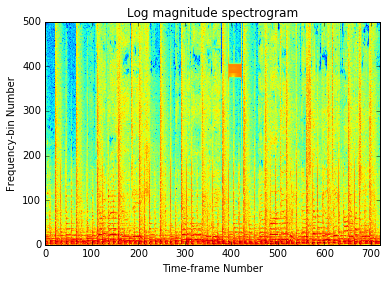

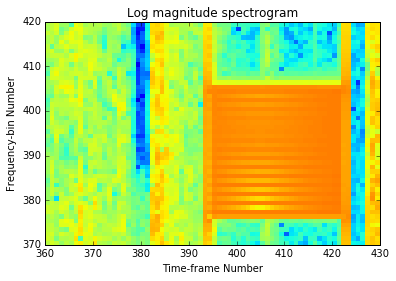

In [5]:
# your code goes here
def spectrogram(signal, window_size, hop_size, sample_rate, window_type = 'hann', display = True ):


    X = signal
    X = np.rot90(X,3)
    sgram = np.array(X[0:len(X)/2])
    sgram = np.abs(sgram) + 0.00000000000001  # this prevents taking the log of 0
    log_sgram = 20 * np.log10(sgram)
    return np.rot90(log_sgram,1)


window_size = 1000
hop_size = 500
police_noisy,sr = librosa.load('police_noisy.wav')
# police_noisy,sr = librosa.load('Booty_Swing.wav')

X = stft(police_noisy, window_size, hop_size, window_type='hann')

# p = spectrogram(X, window_size, hop_size, sr, window_type='hann')
# print p.shape

V,times,freqs = plt_spectrogram(X,window_size, hop_size, sr, zoom_x=None, zoom_y=None,tick_labels='bin-frame')
V = np.abs(V)
# print len(times)
# print len(freqs)
# print V.shape
plt.show()
plt_spectrogram(X,window_size, hop_size, sr, zoom_x=np.array([360,430]), zoom_y=np.array([370,420]),tick_labels='bin-frame')
plt.show()
 

IPython.display.display(Audio(police_noisy, rate=sr))

#### 2. (1 points) Use the frequency and time indices you found in Question 1 to create a simple binary time-frequency mask to remove the region of the ringing noise. The binary mask, *M*, should be of the same size as the magnitude spectrogram *V*. Derive a full (two-sided) time-frequency mask, *M_full*, from *M* and apply it to the STFT of the noisy audio. Compute the denoised signal by tranforming the masked STFT, *X_masked*, back to time domain. Plot the magnitude spectrogram of the denoised audio and check that the region of the ringing noise has been removed. 

#### Explain why  you should apply the time-frequecy mask to the STFT and not to the magnitude spectrogram to extract the noise. Why do we need to derive a *full* time-frequency mask?

We can see that the region of noise has been removed/masked. 

We apply the time-frequency mask to the STFT and not to the magnitude spectrogram because  the STFT contains the complex conjugates and phase information. We need to derive a full time-frequency mask to get rid of both the real and conjugate regions. By applying the mask to the STFT, we can see that the noise is removed from the spectrogram.  

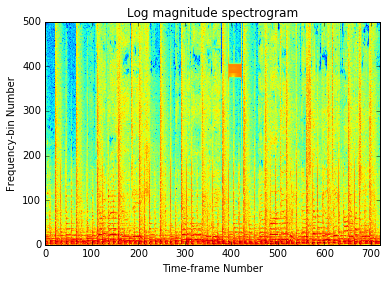

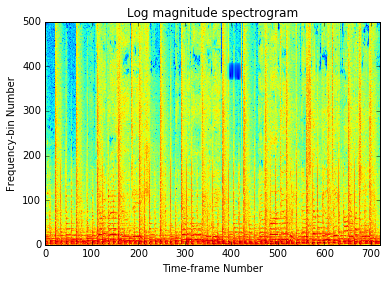

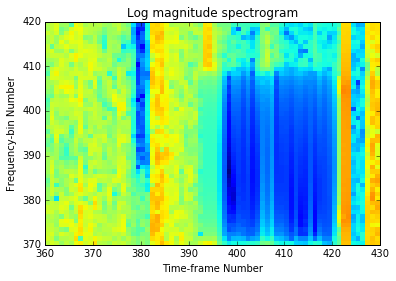

/Users/Atul/miniconda2/envs/eecs352/lib/python2.7/site-packages/IPython/lib/display.py:123: ComplexWarning: Casting complex values to real discards the imaginary part
  data = np.array(data, dtype=float)


In [6]:
# # your code goes here

X = stft(police_noisy, window_size, hop_size, window_type='hann')
X_row,X_col = X.shape
V,times,freqs = plt_spectrogram(X,window_size, hop_size, sr, zoom_x=None, zoom_y=None,tick_labels='bin-frame')
plt.show()
V = np.abs(V)

x1,y1 = V.shape
M = np.ones(V.shape)

M[370:410,392:422] = 0

M_full = np.zeros((2*x1,y1))
M_temp = np.zeros((x1,y1))

index=0

for i in reversed(xrange(x1)):
    M_temp[index,:] = M[i,:]
    index=index+1


M_full = np.vstack([M,M_temp])

# for j in xrange(x1):
#     M_full=np.append(M_full,M[i,:])

# for m in xrange(x1):
#     M_full=np.append(M_full,M_temp[m,:])
    
x_mask = X * M_full

original_rec= istft(x_mask, hop_size)

x3 = stft(original_rec, window_size, hop_size, window_type='hann')
plt_spectrogram(x3,window_size, hop_size, sr, zoom_x=None, zoom_y=None,tick_labels='bin-frame')
plt.show()
plt_spectrogram(x3,window_size, hop_size, sr, zoom_x=np.array([360,430]), zoom_y=np.array([370,420]),tick_labels='bin-frame')
plt.show()
Audio(original_rec, rate=sr)



### Beat Spectrum

#### 3. (1 point) We have provided an implementation of the autocorrelation function. Note that we normalize by the number of nonzero additons. Explain the effect this has (compared to the standard autocorrelation in numpy) and tell us why you think we did this.

In [7]:
def acorr(x):
    """
    Takes a 1D numpy array and returns the autocorrelation. 
    
    Input Parameter:
    ----------------
    x: 1D numpy array of length Lx
    
    Ouput Parameter:
    ----------------
    x_acorr: 1D numpy array of length x_len containing the values of the autocorrelation function of x
    
    Note: the actual length of autocorrelation function is (2*x_len)-1, but since this function is symmetric
          we can cut off (x_len)-1 samples and return one side of length x_len without losing information. 
    """
    
    x_len=np.size(x)
    x_pad=np.concatenate([x,np.zeros(x_len-1)])
    x_acorr=ifft(np.abs(fft(x_pad))**2).real
    x_acorr=x_acorr[0:x_len]
    
    x_acorr=x_acorr/(np.arange(x_len)[::-1]+1)  # normalize by the number of nonzero additions
            
    return x_acorr

# Test case: 
# Note: the numpy correlate function is not normalized so the results seem different. If you comment out the 
#       normalization line above the outputs will be the same.
test_array=np.arange(10)
print 'Output of the accor function:  '+ str(acorr(test_array))
print 'Output of the correlate function:  '+str(np.correlate(test_array,test_array,"full")[len(test_array)-1:2*len(test_array)])


Output of the accor function:  [  2.85000000e+01   2.66666667e+01   2.45000000e+01   2.20000000e+01
   1.91666667e+01   1.60000000e+01   1.25000000e+01   8.66666667e+00
   4.50000000e+00   7.38824206e-14]
Output of the correlate function:  [285 240 196 154 115  80  50  26   9   0]


We normalize by the number of nonzero additions because we are only considering the overlapping portions of the signal. Without normalizing, the places where there is nonzero additions, will lead to a very high peak/amplitude. By normalizing the signal, the period can be more accurately determined. 

#### 4. (2 points) Implement the beat spectrum. Use the autocorrelation function from Question 3. Do not square the magnitude spectrogram within your function; it will be squared outside the function, in the *repet* function. Apply the function to the spectrogram of the noisy as well as the denoised signals. Plot both beat spectra. Do you observe any noticeable difference between the plots? What information does the beat spectrum provide regarding the ringing noise?

I do not observe any noticeable difference between the plots;they have the same pattern. This might be the case because the noise was there for a short duration and taking the mean of the autocorrelation averaged out the noise as well. The beat spectrum tells us that presence of noise does not impact the period of the original signal. In the plot, the y-axis represents mean autocorrelation and the x-axis represents time frames. 

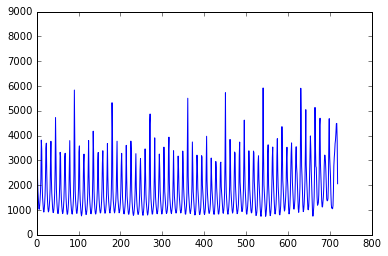

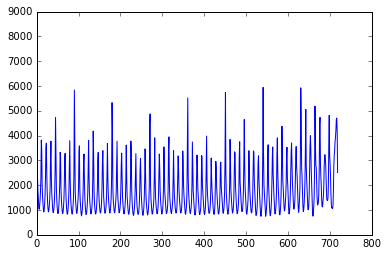

In [8]:
def beat_spectrum(S):
    """
    Computes the beat spectrum of a music mixture by applyting the autocorrelation to all frequency channels (rows)
    of the spectrogram and taking the average. Note that the assumption is that the mixture is composed of a repeating
    background and a non-repeating foreground. Therefore, the spikes in the beat spectrum represent the repetitive 
    events in the spectrogram.  This function must PLOT the beat spectrum for viewing, since you'll be looking at the
    resulting plot to pick the repeating period used by REPET. 
    
    Input Parameter:
    ----------------
    S: 2D numpy array containng the spectrogram of a signal
    
    Output Parameter:
    ------------------
    beat_spec: 1D numpy array containing the beat spectrum 
    
    """
    
    x,y = S.shape

    beat_spec = []
    beat_spec_temp = np.zeros((x,y))
    counter=0
    for i in xrange(x):
        beat_spec_temp[i,:] =acorr(S[i,:])
    
    for j in xrange(y):
        temp1 = np.mean(beat_spec_temp[:,j])
        beat_spec.append(temp1)


    
    plt.plot(beat_spec),plt.show()
    
    
    return beat_spec
    
    # your code goes here
# V,times,freqs = plt_spectrogram(X,window_size, hop_size, sr, zoom_x=None, zoom_y=None,tick_labels='bin-frame')
# plt.show()
# beat_spectrum(V**2)
x3 = stft(original_rec, window_size, hop_size, window_type='hann')
temp1,temp2=x3.shape
x3 = np.abs(x3[0:(temp1/2)])
beat_spectrum(x3**2)
V = np.abs(X[0:(X_row/2)])
signal_plot = beat_spectrum(V**2)


#### 5. (1 point) Explain how you would find the period of the repeating structure from the beat spectrum. Remember that the repeating period does not necessarily correspond to the first highest peak. Remember also that the beat spectrum goes from lag 0 to lag n-1, where n is the length of the input signal.

I found the period of the repeating structure by zooming in on a section of the beat spectrum. As shown in the plot below, the beat spectrum shows several local peaks but there are distinct peaks at a certain interval. The period seems to be 90 time frames. In other words, after every 90 time frames, there seems to be a max peak. Note: x-axis shows time frames while the y-axis shows mean autocorrelation. 

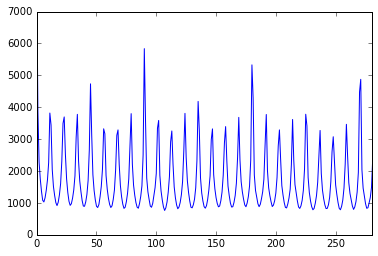

In [9]:
# Plot the log magnitude spectrogram
plt.axis([0,280,0,7000])
plt.plot(signal_plot)

### REPET Algorithm

#### 6. (2 point) Implement a repeating-segment modeling function (Hint: use the numpy *median* function). Note that after segmentation of the spectrogram, the last segment is generally shorter (in time frames) than the other segments, because the number of time frames is not necessarily an integer multiple of the repeating period; Think about how you would handle that.

In [10]:
def repeating_segment(V,p):
    """
    Computes the repeating-segment model using the period obtained from the beat spectrum. The repeating segment
    is that median background we'll be using to compare to the spectrum. Its time duration will be the length of
    one period that you learned from the beat spectrum. 
    
    Input Parameters:
    -----------------
    V: 2D numpy array containing the magnitude spectrogram of the mixture
    p: scalar, repeating period (in number of samples) found from the beat spectrum 
    
    Output Parameter:
    S: 2D numpy array containing the repeating segment 
    """  
    # your code goes here
    
    rows,cols = V.shape
    index=0
    zero_column=[]
    
    
    #To handle instances when frames is not an integer multiple, I added nan's. Doing 'nanmedian' ignores the nan values.

    for j in xrange(rows):
 
        zero_column.append(np.nan)
        
    #If V doesn't contain perfect number of periods, add column of nans
    while ((cols+index)%p)!=0:
        V=np.column_stack([V,zero_column])
        index=index+1
        
    print V
    
    
    
    rows_ed,cols_ed = V.shape
   
  
    #It splits the magnitude spectrogram V into different indices that I care for
    V_splitted =V.reshape(1, rows_ed, -1, p).swapaxes(1,2).reshape(-1, rows_ed, p)
   

    print V_splitted
    
    index_array = []
    index_2 = 0
    counter =0
    
#     while (counter < cols_ed):
#         index_array.append(index_2)
#         index_2=index_2+1
#         counter =counter + p
#     print index_array
    
#     median_index=np.nanmedian(index_array, axis=None, out=None, overwrite_input=False, keepdims=False)
#     print median_index
#     actual_index = median_index * p
#     S = V[:,actual_index:actual_index+p]
 
    S = np.nanmedian(V_splitted,axis=0,out=None, overwrite_input=False, keepdims=False)


    return S

# p=90

#### 7. (2 point) Implement a repeating spectrogram modeling function (Hint: use the min function). Again, the last segment in your spectrogram is generally shorter than the repeating segment model. 

In [11]:
def repeating_spectrogram(V,S,p):
    """
    Builds the repeating-spectrogram model using the repeating segment model computed in the previous question.
    This is composed of multiple copies of the repeating segment, tiled together in the time-dimension so that it
    is the exact same size as the input signal's spectrogram.
    
    Input Parameters:
    -----------------
    V: 2D numpy array containing the magnitude spectrogram of the mixture
    S: 2D numpy array containing the repeating segment model 
    
    Output Parameter:
    ------------------
    W: 2D numpy array containing the repeating-spectrogram 
    """
    # your code goes here
    no_rows, no_cols = V.shape


    index=0
    zero_column=np.zeros(no_rows)


#     V_update = np.zeros((no_rows,no_cols))
    
    
    #To handle instances when frames is not an integer multiple, I added nan's. Doing 'nanmedian' ignores the nan values.

        
    #If V doesn't contain perfect number of periods, add column of nans
    while ((no_cols+index)%p)!=0:
        V=np.column_stack([V,zero_column])
        index=index+1
    print V
    
    up_rows, up_cols = V.shape
    W = np.zeros((up_rows,up_cols))
#     print W.shape
#     print V.shape
    no_tiles = up_cols/p
#     print no_tiles
#     print S.shape
    repeating_seg = np.zeros((up_rows,up_cols))
    repeating_seg = np.tile(S,no_tiles)
    W = np.minimum(repeating_seg,V)
    return W
    

    

#### 8. (1 point) Implement a repeating-mask modeling function (Hint: use a division). Note that there could be zero values in your spectrogram. Think about how to handle that. 

In [12]:
def repeating_mask(V,W):
    """
    Before we do our separation, we need to compare our repeating_spectrogram to the original spectrogram of the signal
    to determine how to assign the energy in each time-frequency point (each element in your matrix). This function
    does that and makes a mask that will be applied to the spectrum. Note that unlike the denoising case in the first 
    question, here we are computing a "soft mask" with values ranging between 0 and 1.
    
    Input Parameters:
    -----------------
    V: numpy 2D array containing the magnitude spectrogram 
    W: numpy 2D array containing the repeating spectrogram
    
    Output Parameter:
    M: numpy 2D array containing the repeating mask 
    """
    # your code goes here
    #Based on what was taught in class, this is how I implemented a repeating mask. W+e/V+e, where e is error
    no_rows,no_cols = V.shape
    W = W[:,:no_cols]
    error = 0.00000000000000000000001
    M = (W+error)/(V+error)
    return M
 


### Music-voice Separation

#### 9.  (2 points) The function provided below runs the REPET algorithm using functions you wrote in previous questions. REPET builds a soft time-frequency mask (with values between 0 and 1), but we can also derive a binary time-frequency mask from it (with values of only 0s and 1s). To do so, we simply use a threshold value between 0 and 1 in the soft mask, so that values above the threshold will be forced to 1, while values below the threshold will be forced to 0. A binary mask can help to improve the perception of separation, but it will also increase the separation artifacts. 

#### Select the value of the repeating period in samples and the value of the masking threshold. Try different values of the masking threshold and compute the background and foreground audio estimates. Listen to the estimate and plot the magnitude spectrograms of the background and foreground estimates for each masking threshold you try. Write down the value of the masking threshold that gave you the best separation results.

#### Describe the separation results that you have obtained. Are the repeating musical background and the non-repeating vocal foreground well separated? Did you get any kind of audio artifacts? What did happen to the ringing noise? Why? 

In [13]:
def repet(file_path, rep_period, mask_thr):
    """
    Runs the REPET algorithm using functions implemented in qustions 3 through 8. NOTE: In the real REPET algorithm
    it also determines the repeating period from the beat spectrum by building a peak picker to find the best
    period from the beat spectrum. This seemed like too much for a homework, so we're making YOU the peak picker. 
    You'll have to run the beat_spectrum function before calling repet and input the value for rep_period.
    
    Input Parameters:
    ------------------
    file_path: string, path to the audio file to separate
    rep_period: scalar, repeating period in number of samples
    mask_thr: scalar, a value between 0 and 1 for thresholding the soft mask
    
    Output:
    --------
    Separated background and foreground magnitude spectrogram plots 
    
    Returns: 
    ---------
    Separated background and foreground time signals
    """
    
    # Load the noisy mixture
    signal, sample_rate = librosa.load(file_path, 44100) 

    # Comput the stft of the audio signal 
    win_length_sec=0.04 # 40 msec window
    win_length_samp=int(2**np.ceil(np.log2(win_length_sec*sample_rate))) # next power2 of winow length in no. of samples
    n_fft=win_length_samp
    hop_size=win_length_samp/2 # 50% overlap
    win_type=sp.signal.hanning
    X = stft(signal, win_length_samp, hop_size, window_type = 'hann')

    # Compute the magnitude spectrogram (half spectrum)
    Vm = np.abs(X[0:win_length_samp/2+1,:])
    Nf,Nt=Vm.shape
    
    
    # Compute and plot the beat spectrum
    beat_spec = beat_spectrum(Vm**2)
    beat_spec = beat_spec/beat_spec[0] # normalization
    
    plt.figure()
    plt.plot(beat_spec)
    plt.grid('on')
    plt.axis('tight')
    plt.xlabel('Lag (sample number)')
    plt.title('Beat spectrum of the noisy mixture')
    
    ### REPET Algorithm ###
    
    # Compute the repeating soft mask
    Sm=repeating_segment(Vm,rep_period)
    Wm=repeating_spectrogram(Vm,Sm,rep_period)
    soft_mask=repeating_mask(Vm,Wm)
    
    #plt.figure()
    #plt.pcolormesh(soft_mask)
    
    # Compute the repeating binary mask
    binary_mask=np.zeros(soft_mask.shape)
    binary_mask[soft_mask>=mask_thr]=1
    
    
    # Estimate the background and foreground via masking
    binary_mask=np.vstack([binary_mask,np.flipud(binary_mask[1:-1,:])])
    
    X_bg = binary_mask*X+1e-16  # background STFT
    signal_bg = np.real(istft(X_bg, hop_size)) # background time signal
    
    X_fg = (1-binary_mask)*X+1e-16  # foreground STFT
    signal_fg = np.real(istft(X_fg, hop_size)) # foreground time signal
            
    # Plot the log magnitude spectrograms and the binary mask
    plt.figure()    
    plt.subplot(211)
    plt_spectrogram(X,win_length_samp, hop_size, sample_rate,tick_labels='time-freq')
    plt.title('Mixture')
        
    plt.subplot(212)
    plt.pcolormesh(binary_mask[0:Nf,:])
    plt.xlabel('Time (sec)')
    plt.ylabel('Frequency (Hz)')
    plt.title('Binary mask')
    plt.axis('tight')
    
    plt.figure()
    plt.subplot(211)
    plt_spectrogram(X_bg,win_length_samp, hop_size, sample_rate,tick_labels='time-freq')
    plt.title('Background')
    
    plt.subplot(212)
    plt_spectrogram(X_fg,win_length_samp, hop_size, sample_rate,tick_labels='time-freq')
    plt.title('Foreground')
    
    return signal_bg,signal_fg

    

Threshold of 0.2


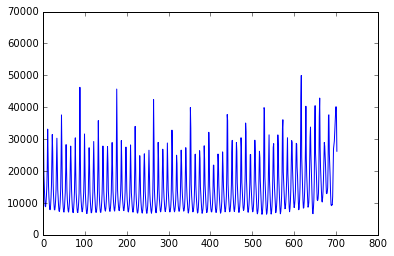

[[  2.17977915e+00   1.13898211e+01   9.36058943e+00 ...,              nan
               nan              nan]
 [  1.37903457e+01   3.61232994e+00   1.12407304e+01 ...,              nan
               nan              nan]
 [  3.70424935e+01   5.72053832e+01   1.56478931e+01 ...,              nan
               nan              nan]
 ..., 
 [  2.54723187e-03   3.80578426e-03   1.42471789e-03 ...,              nan
               nan              nan]
 [  2.47096543e-03   3.87709865e-03   2.33480196e-03 ...,              nan
               nan              nan]
 [  8.79141395e-04   4.81861958e-03   2.56541988e-03 ...,              nan
               nan              nan]]
[[[  2.17977915e+00   1.13898211e+01   9.36058943e+00 ...,   1.85924972e+00
     2.10063298e+00   4.31693322e+00]
  [  1.37903457e+01   3.61232994e+00   1.12407304e+01 ...,   6.96694441e+00
     5.65074537e+00   1.35793807e+01]
  [  3.70424935e+01   5.72053832e+01   1.56478931e+01 ...,   1.44401261e+01
     4.77030995e

Threshold of 0.5


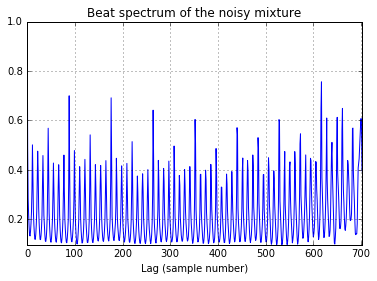

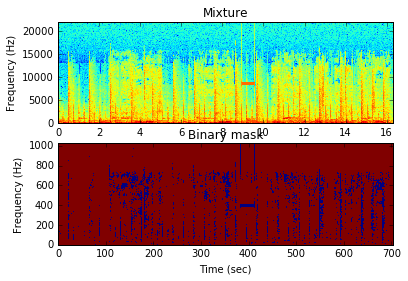

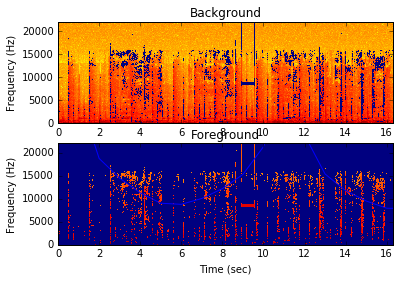

[[  2.17977915e+00   1.13898211e+01   9.36058943e+00 ...,              nan
               nan              nan]
 [  1.37903457e+01   3.61232994e+00   1.12407304e+01 ...,              nan
               nan              nan]
 [  3.70424935e+01   5.72053832e+01   1.56478931e+01 ...,              nan
               nan              nan]
 ..., 
 [  2.54723187e-03   3.80578426e-03   1.42471789e-03 ...,              nan
               nan              nan]
 [  2.47096543e-03   3.87709865e-03   2.33480196e-03 ...,              nan
               nan              nan]
 [  8.79141395e-04   4.81861958e-03   2.56541988e-03 ...,              nan
               nan              nan]]
[[[  2.17977915e+00   1.13898211e+01   9.36058943e+00 ...,   1.85924972e+00
     2.10063298e+00   4.31693322e+00]
  [  1.37903457e+01   3.61232994e+00   1.12407304e+01 ...,   6.96694441e+00
     5.65074537e+00   1.35793807e+01]
  [  3.70424935e+01   5.72053832e+01   1.56478931e+01 ...,   1.44401261e+01
     4.77030995e

Threshold of 0.7


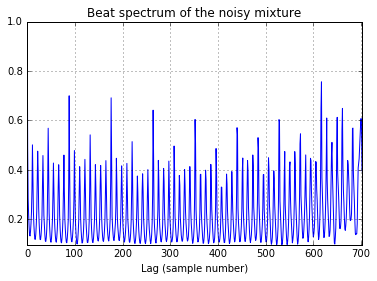

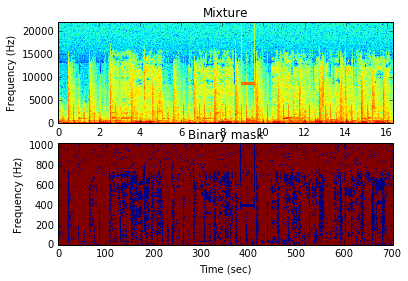

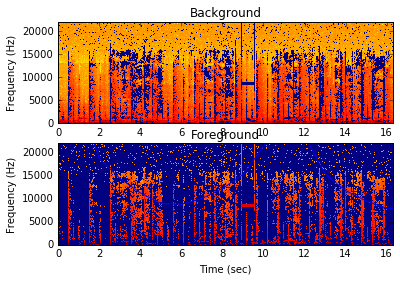

[[  2.17977915e+00   1.13898211e+01   9.36058943e+00 ...,              nan
               nan              nan]
 [  1.37903457e+01   3.61232994e+00   1.12407304e+01 ...,              nan
               nan              nan]
 [  3.70424935e+01   5.72053832e+01   1.56478931e+01 ...,              nan
               nan              nan]
 ..., 
 [  2.54723187e-03   3.80578426e-03   1.42471789e-03 ...,              nan
               nan              nan]
 [  2.47096543e-03   3.87709865e-03   2.33480196e-03 ...,              nan
               nan              nan]
 [  8.79141395e-04   4.81861958e-03   2.56541988e-03 ...,              nan
               nan              nan]]
[[[  2.17977915e+00   1.13898211e+01   9.36058943e+00 ...,   1.85924972e+00
     2.10063298e+00   4.31693322e+00]
  [  1.37903457e+01   3.61232994e+00   1.12407304e+01 ...,   6.96694441e+00
     5.65074537e+00   1.35793807e+01]
  [  3.70424935e+01   5.72053832e+01   1.56478931e+01 ...,   1.44401261e+01
     4.77030995e

Threshold of 0.8


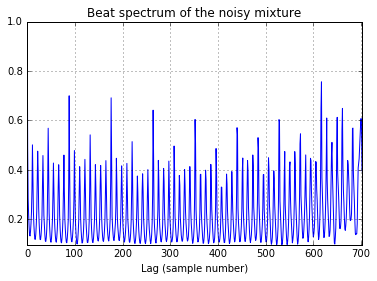

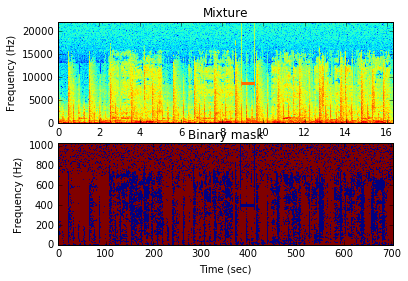

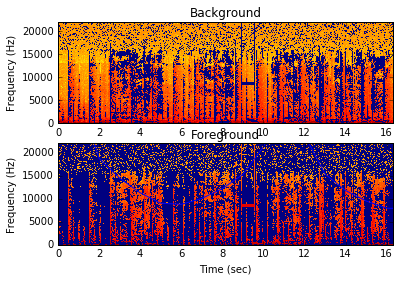

[[  2.17977915e+00   1.13898211e+01   9.36058943e+00 ...,              nan
               nan              nan]
 [  1.37903457e+01   3.61232994e+00   1.12407304e+01 ...,              nan
               nan              nan]
 [  3.70424935e+01   5.72053832e+01   1.56478931e+01 ...,              nan
               nan              nan]
 ..., 
 [  2.54723187e-03   3.80578426e-03   1.42471789e-03 ...,              nan
               nan              nan]
 [  2.47096543e-03   3.87709865e-03   2.33480196e-03 ...,              nan
               nan              nan]
 [  8.79141395e-04   4.81861958e-03   2.56541988e-03 ...,              nan
               nan              nan]]
[[[  2.17977915e+00   1.13898211e+01   9.36058943e+00 ...,   1.85924972e+00
     2.10063298e+00   4.31693322e+00]
  [  1.37903457e+01   3.61232994e+00   1.12407304e+01 ...,   6.96694441e+00
     5.65074537e+00   1.35793807e+01]
  [  3.70424935e+01   5.72053832e+01   1.56478931e+01 ...,   1.44401261e+01
     4.77030995e

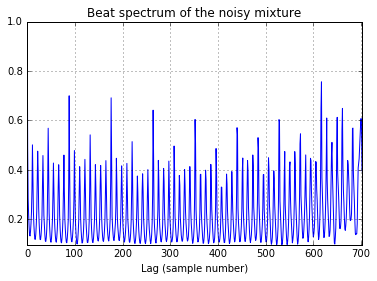

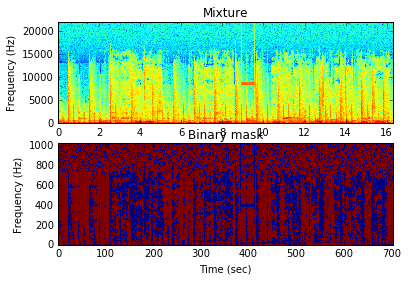

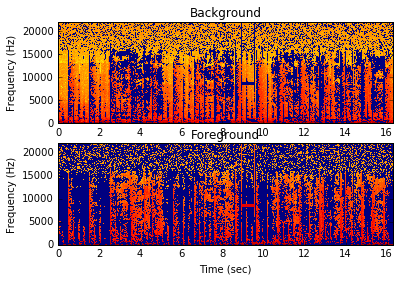

In [14]:
# your code goes here
mask_thr1,mask_thr2,mask_thr3,mask_thr4 = 0.2,0.5,0.7,0.8
print "Threshold of 0.2"
signal_bg1, signal_fg1 = repet("police_noisy.wav", 90, mask_thr1)
IPython.display.display(Audio(signal_bg1, rate=44100))
IPython.display.display(Audio(signal_fg1, rate=44100))
print "Threshold of 0.5"
signal_bg2, signal_fg2 = repet("police_noisy.wav",90,mask_thr2)
IPython.display.display(Audio(signal_bg2, rate=44100))
IPython.display.display(Audio(signal_fg2, rate=44100))
print "Threshold of 0.7"
signal_bg3, signal_fg3 = repet("police_noisy.wav", 90, mask_thr3)
IPython.display.display(Audio(signal_bg3, rate=44100))
IPython.display.display(Audio(signal_fg3, rate=44100))
print "Threshold of 0.8"
signal_bg4, signal_fg4 = repet("police_noisy.wav",90,mask_thr4)
IPython.display.display(Audio(signal_bg4, rate=44100))
IPython.display.display(Audio(signal_fg4, rate=44100))

I ran the repet algorithm for four different threshold values: 0.2, 0.5,0.7 and 0.8. The repeating period I determined was 90 time frames from my beat spectrum. The background and foreground noise were seperated to different extents based on the thresholds that I specified. A threshold of 0.7 seemed to have the best separation, in that it separated the repeating rhythms of the music and the vocals better than other thresholds did. However, we can still hear some vocals in the background and some beats in the foreground. Thus, the separation is not perfect. The ringing noise stays in the foreground, primarily because it is a momentary sound and does not repeat. At lower thresholds like 0.2 and 0.7, I got a distorted foreground recording/artifact. The vocals sounded a bit monotonous and it seemed there was some sort of a filter through which the vocals was outputed. Higher thresholds gave normal sounding vocals/foreground. 

#### 10. (2 points) Go out on the web and find an example of music where REPET works well to separate out the voice and an example where it works poorly and do the following:
1. Crop each example to be between 10 and 30 seconds (pick a length appropriate for making your point)
1. Save each cropped example at the sample rate 22050 Hz
1. Make each example monophonic (ie one channel, not two)
1. Include both examples with your submission
1. Write the code to call repet, separate the sources and play them.

I played these two songs: Imagine by John Lennon and Booty Swing by Parov Stelar. The sepearation works better for Booty Swing. This is mainly because the beats in the song are very constant throughout the sample and the separation is easier. The song doesn't have much vocals and that might be one of the reasons why the background music seems to be clear and distinct.  

Imagine, by John Lennon does not produce good source separation. There is a bunch of musical instruments used and the beats are not as regular as Booty Swing. In the background music for Imagine, I can still hear John Lennon's vocals. 

Booty Swing


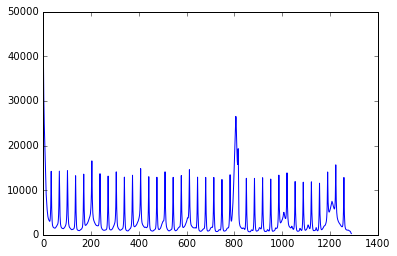

[[  5.39715615e-01   7.39340806e-01   1.23587991e+00 ...,              nan
               nan              nan]
 [  6.25111532e-01   1.32177626e+00   3.17796551e+00 ...,              nan
               nan              nan]
 [  3.71928566e-01   4.52318336e+00   2.97218061e+00 ...,              nan
               nan              nan]
 ..., 
 [  1.06071307e-03   1.31002133e-03   1.70577650e-04 ...,              nan
               nan              nan]
 [  1.44022251e-03   1.01382385e-03   4.73089198e-04 ...,              nan
               nan              nan]
 [  1.33781919e-03   1.96034122e-04   9.34058529e-04 ...,              nan
               nan              nan]]
[[[  5.39715615e-01   7.39340806e-01   1.23587991e+00 ...,   1.60735205e-01
     4.34445334e-01   9.10814335e-02]
  [  6.25111532e-01   1.32177626e+00   3.17796551e+00 ...,   3.93221812e-01
     6.29689725e-01   4.64939152e-01]
  [  3.71928566e-01   4.52318336e+00   2.97218061e+00 ...,   5.06581880e-01
     1.19084998e

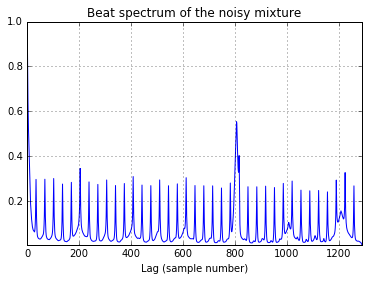

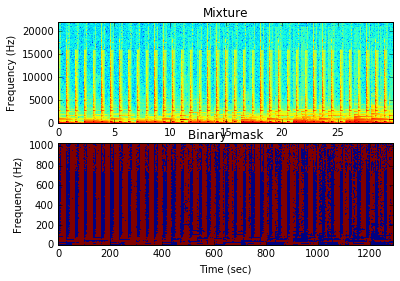

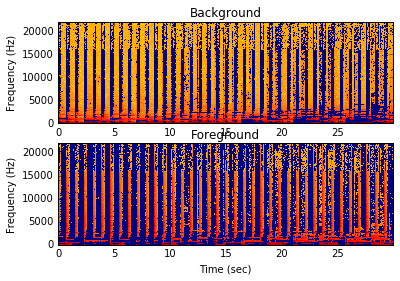

In [17]:
# your code goes here
# Testing One song
# sr1=22050
# sr1,Imagine=sp.io.wavfile.read("Imagine.wav")
# print "Imagine"
# signal_bg, signal_fg= repet("Imagine.wav", 200, .5)
# IPython.display.display(Audio(signal_bg, rate=sr1))
# IPython.display.display(Audio(signal_fg, rate=sr1))

# #Testing second song
# sr1,booty_swing=sp.io.wavfile.read("Booty_Swing.wav")
print "Booty Swing"
signal_bg5, signal_fg5= repet("satie_w_cowbell.wav", 80, .7)
IPython.display.display(Audio(signal_bg5, rate=44100))
IPython.display.display(Audio(signal_fg5, rate=44100))

